# Predecir la población de cada país para los próximos 4 años (Resume)
### *Ventagium Test*, 2021 07 12, FE Charry-Pastrana, charrypastranaernesto@gmail.com

Procedimiento seguido: 
1. Exploración de datos

    1.1 **Visualización** de los datos: comportamiento exponencial.
    
    1.2. **Correlación de** Población total con otras Variables (Net migration, Mortality rate - adult - male and female, Fertility rate). 
    
    
2. Modelado de datos: 

    2.1 Función **exponencial** para todo el intervalo temporal. 
    
    2.2. Función exponencial para los últimos 20 años.
    
    2.3. Función exponencial para los últimos 20 años + **Método de Monte Carlo** básico. 
    
    2.4. Función exponencial a trozos (**ventana de 4 años**) **+** corrección (**promedio** de dos años anteriores)
    
    2.5. Método lineal incluyendo **otras variables**, P(t, x_i) = Date + Variable_i
    
    2.6. Método lineal incluyendo otras variables y utilizando Monte Carlo básico para predecir Problación.


Teoría utilizada: 
- Comportamiento líneal.
- Correlación. 
- Probabilidad (Monte Carlo).

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests
import scipy
from scipy.optimize import curve_fit
import random
from scipy.stats.stats import pearsonr 

from sklearn.svm import SVR

# 0. Download or load data

In [2]:
def download_indicator(indicator):
    # Given a indicator, download all the data
    seed = 'http://api.worldbank.org/v2/country/all/indicator/'+indicator+'?format=json'
    response_seed = requests.get(seed).json()
    df = pd.DataFrame.from_dict(response_seed[1])

    for page in range(2, response_seed[0]['pages']+1): 
        url = 'http://api.worldbank.org/v2/country/all/indicator/'+indicator+'?page='+str(page)+'&format=json'
        response = requests.get(url).json()
        df = df.append(pd.DataFrame.from_dict(response[1]), ignore_index=True)
    return df

In [3]:
%%time
# df = download_indicator('SP.POP.TOTL')

# df_1 = download_indicator('SM.POP.NETM')
# df_2 = download_indicator('SP.DYN.AMRT.MA')
# df_3 = download_indicator('SP.DYN.AMRT.FE')
# df_4 = download_indicator('SP.DYN.TFRT.IN')

# df['date'] = df['date'].astype(float)
# df_1['date'] = df_1['date'].astype(float)
# df_2['date'] = df_2['date'].astype(float)
# df_3['date'] = df_3['date'].astype(float)
# df_4['date'] = df_4['date'].astype(float)

# df_group = df[df['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
# df_group_1 = df_1[df_1['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
# df_group_2 = df_2[df_2['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
# df_group_3 = df_3[df_3['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()
# df_group_4 = df_4[df_4['date']>=1990].groupby(['countryiso3code', 'date'])['value'].sum().copy()

df = pd.read_csv('data/df.csv')
df_1 = pd.read_csv('data/df_1.csv')
df_2 = pd.read_csv('data/df_2.csv')
df_3 = pd.read_csv('data/df_3.csv')
df_4 = pd.read_csv('data/df_4.csv')

df_group = pd.read_csv('data/df_group.csv', index_col = ['countryiso3code', 'date'])
df_group_1 = pd.read_csv('data/df_group_1.csv', index_col = ['countryiso3code', 'date'])
df_group_2 = pd.read_csv('data/df_group_2.csv', index_col = ['countryiso3code', 'date'])
df_group_3 = pd.read_csv('data/df_group_3.csv', index_col = ['countryiso3code', 'date'])
df_group_4 = pd.read_csv('data/df_group_4.csv', index_col = ['countryiso3code', 'date'])

df_all = df_group_1.merge(df_group_2, how='outer', 
                            on=['countryiso3code', 'date'], 
                            suffixes=('_1', '_2')
                           ).merge(df_group_3, how='outer', 
                            on=['countryiso3code', 'date']
                                  ).merge(df_group_4, how='outer', 
                                          on=['countryiso3code', 'date'], 
                                          suffixes=('_3', '_4')
                                         ).merge(df_group, how='outer',
                                                 on=['countryiso3code', 'date']
                                                )

df_all.reset_index(level=['date'], inplace=True)

CPU times: user 131 ms, sys: 16.6 ms, total: 147 ms
Wall time: 164 ms


# 1.1 Visualización de los datos: comportamiento exponencial

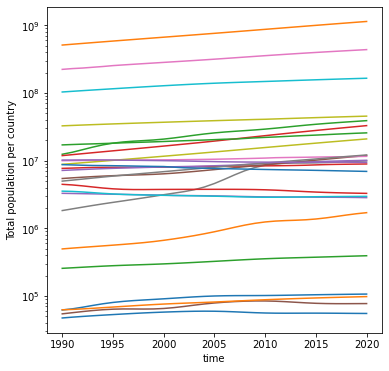

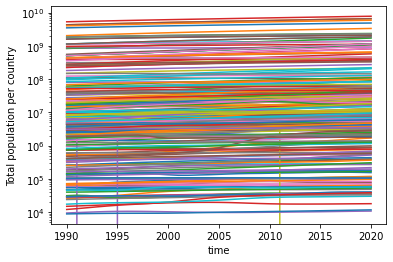

In [4]:
countries = df_group.index.get_level_values(0).unique()

plt.figure(figsize=(6, 6))

for country in countries[0:25]:
    plt.plot(df_group.loc[country])

plt.yscale("log")
plt.xlabel("time")
plt.ylabel("Total population per country")
plt.show()

for country in countries:
    plt.plot(df_group.loc[country])

plt.yscale("log")
plt.xlabel("time")
plt.ylabel("Total population per country")
plt.show()

# 1.2 Correlación de Población total con otras Variables (Net migration, Mortality rate - adult - male and female, Fertility rate): se descarta la variable Net migration.

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/

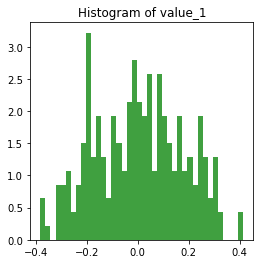

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/

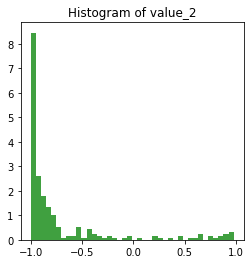

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/

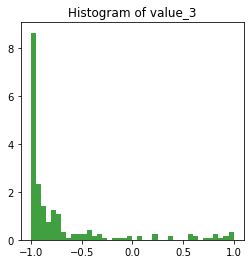

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3913: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/charrypastrana/opt/anaconda3/lib/

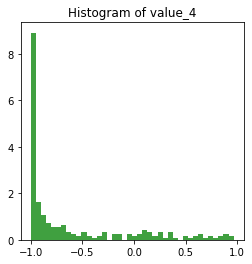

In [5]:
countries = df_all.index.get_level_values(0).unique()

for value_i in ['value_1', 'value_2', 'value_3', 'value_4']:
    value_i_list = []
    
    for country in countries:
        if country != 'ERI' and country != 'KWT': 
            y = df_all[df_all['date']!=2020].loc[country][value_i].values
            y2 = np.log(df_all[df_all['date']!=2020].loc[country]['value'].values.tolist())
            value_i_list.append(pearsonr(y,y2)[0])

    plt.figure(figsize=(4, 4))
    plt.title('Histogram of '+value_i)
    plt.hist(value_i_list, 40, density=True, facecolor='g', alpha=0.75)
    plt.show()

# 2.1 Función exponencial para todo el intervalo temporal.

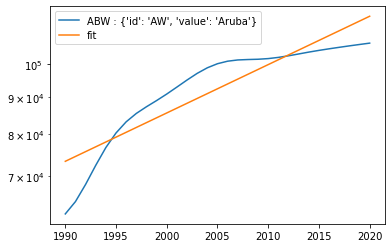

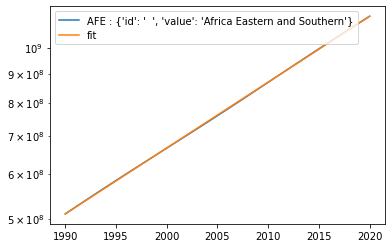

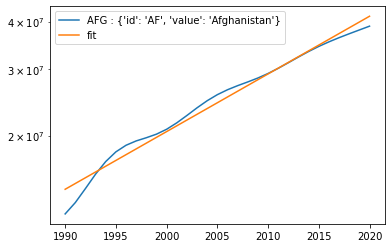

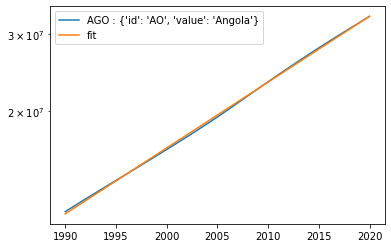

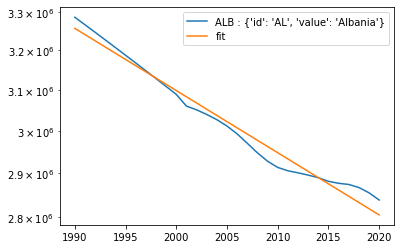

...

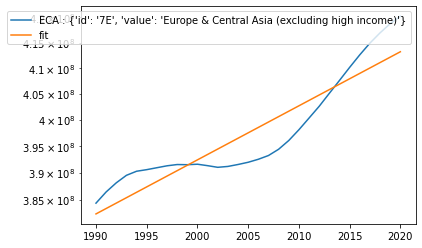

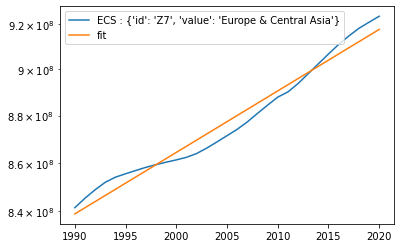

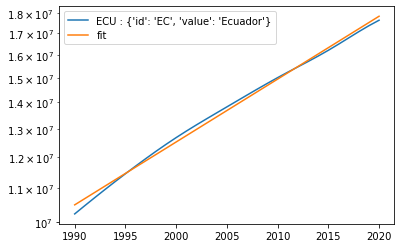

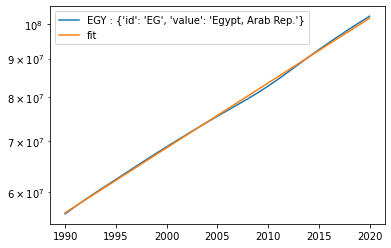

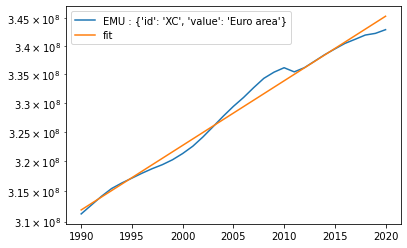

<ipython-input-6-fcd203ff155e>:11: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


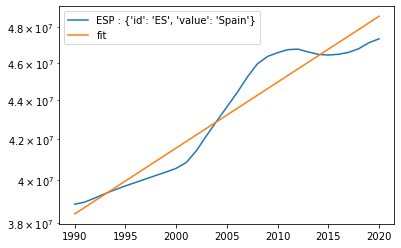

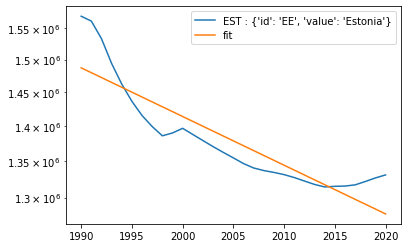

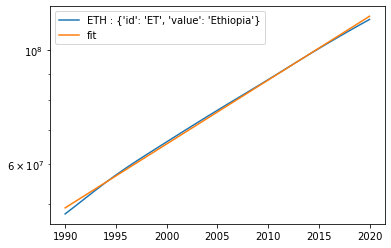

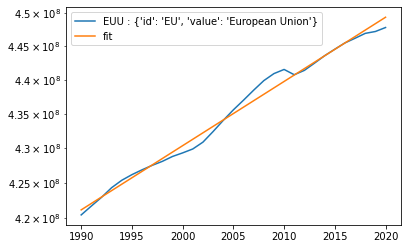

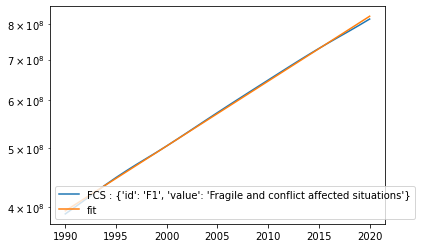

...

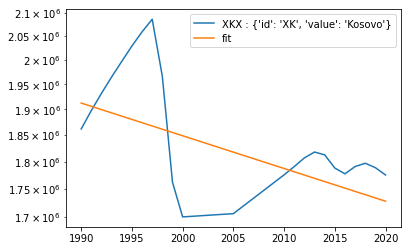

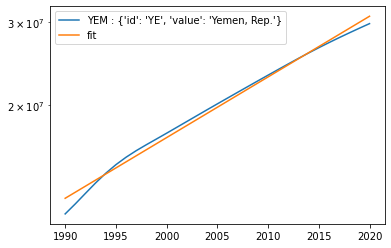

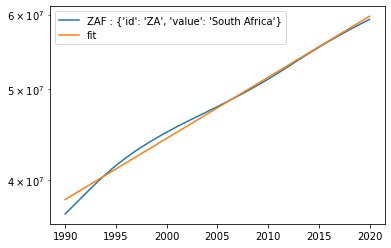

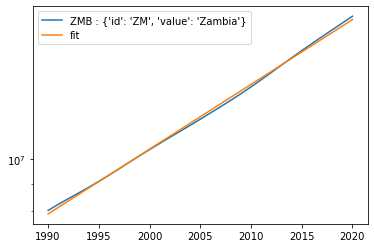

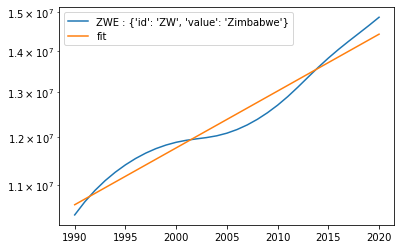

Pass_count total:  258
Pass_count total (%):  99.23076923076923


In [6]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

pass_count = 0 # counter

for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
    if res > 0: # 0.1, < 0 to plot all of them
        y_fit = [fit_funtion(x_i, parameters) for x_i in x] 
        plt.plot(x,y, label = country + ' : ' + full_name_country)
        plt.plot(x, y_fit, label = 'fit')
        plt.yscale("log")
        plt.legend()
        plt.show()
        pass_count += 1

print('Pass_count total: ', pass_count)
print('Pass_count total (%): ', pass_count*100/len(countries))


# 2.2. Función exponencial para los últimos 20 años.

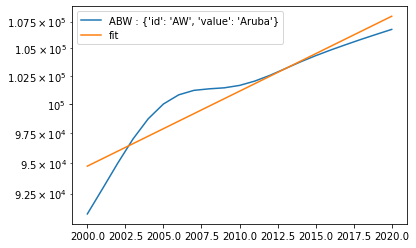

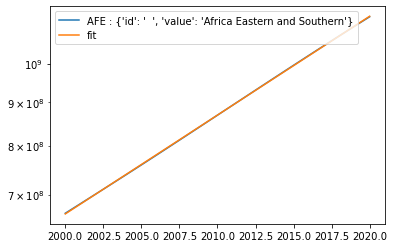

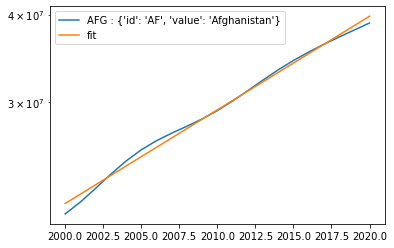

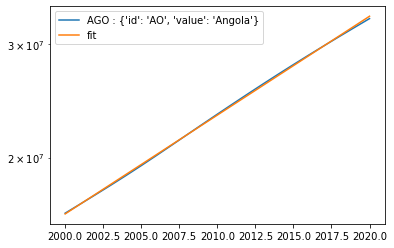

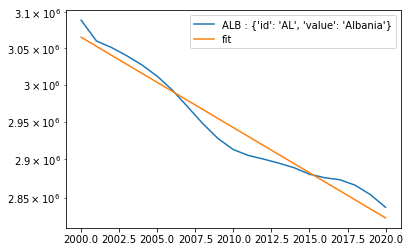

...

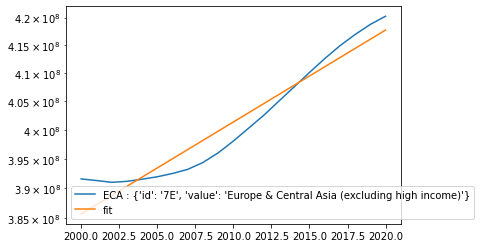

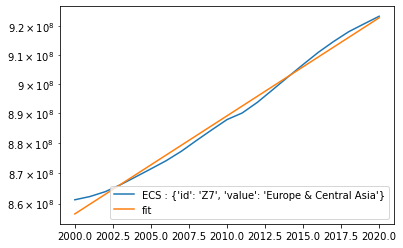

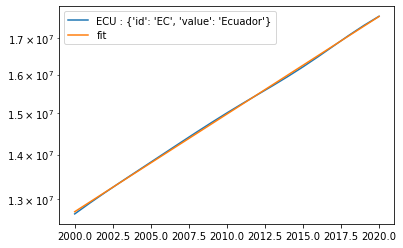

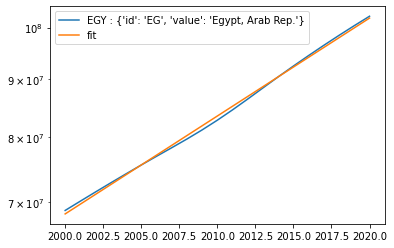

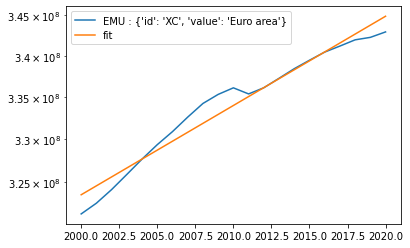

<ipython-input-7-2f31504495bc>:15: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)


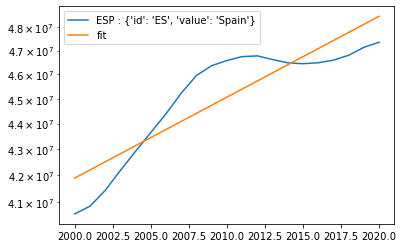

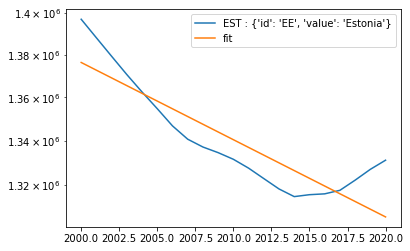

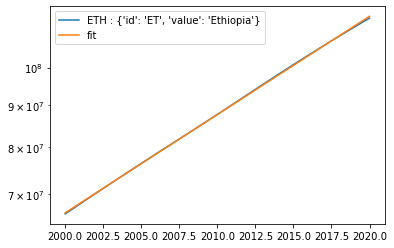

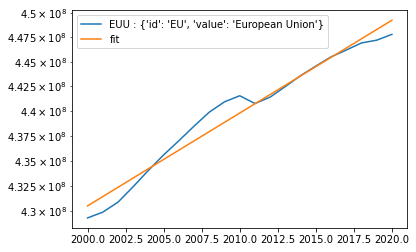

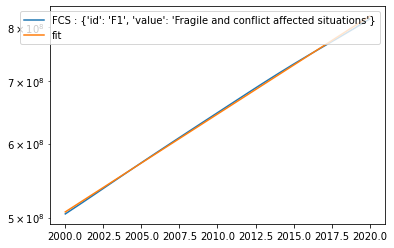

...

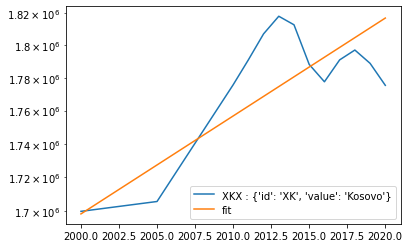

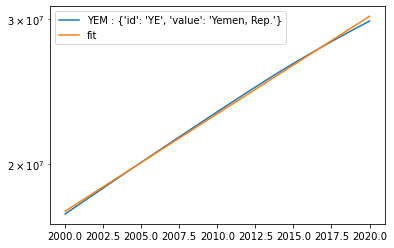

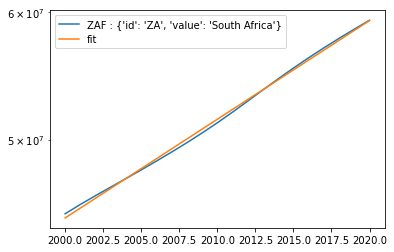

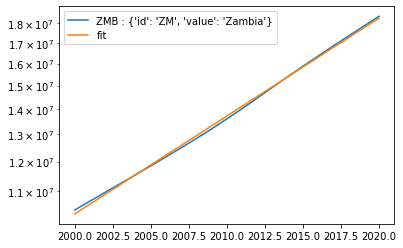

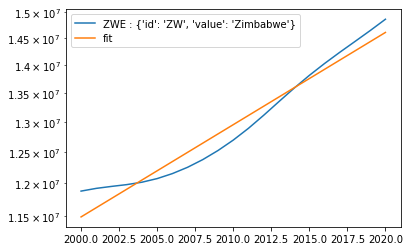

Pass_count total:  259
Pass_count total (%):  99.61538461538461


In [7]:
# Countries
df_group = df[df['date']>=2000].groupby(['countryiso3code', 'date'])['value'].sum().copy()

countries = df_group.index.get_level_values(0).unique()

def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

pass_count = 0 
for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
    if res > 0:
        y_fit = [fit_funtion(x_i, parameters) for x_i in x]
        plt.plot(x,y, label = country + ' : ' + full_name_country)
        plt.plot(x, y_fit, label = 'fit')
        plt.yscale("log")
        plt.legend()
        plt.show()
        pass_count += 1

print('Pass_count total: ', pass_count)
print('Pass_count total (%): ', pass_count*100/len(countries))

# 2.3. Función exponencial para los últimos 20 años + Método de Monte Carlo básico.

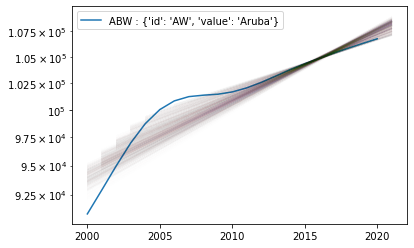

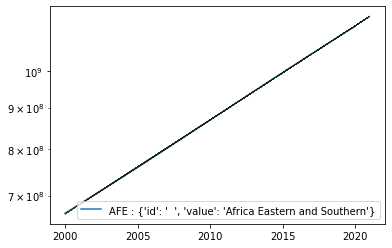

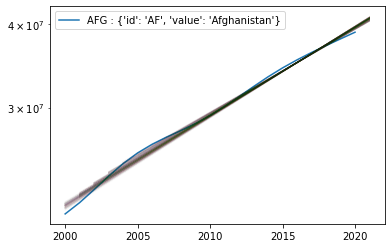

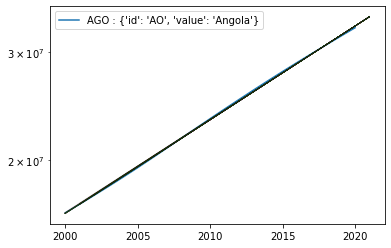

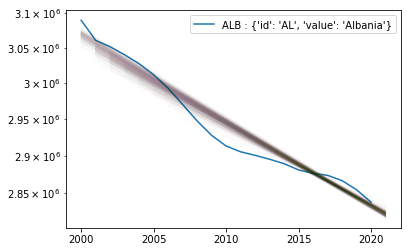

...

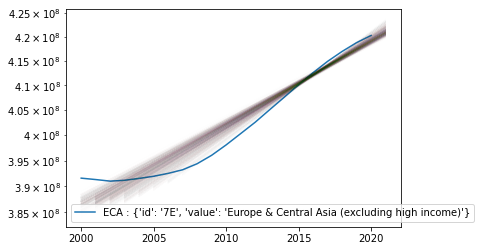

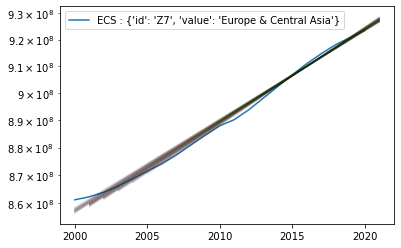

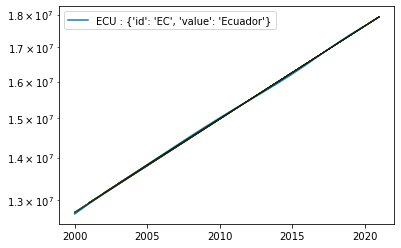

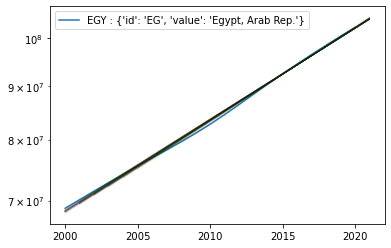

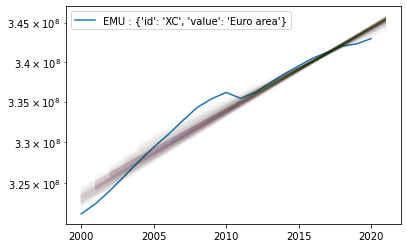

<timed exec>:21: RuntimeWarning: divide by zero encountered in log


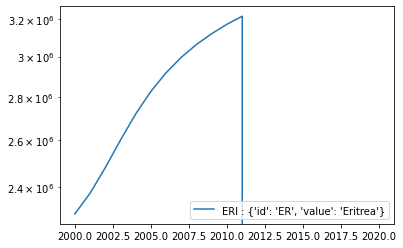

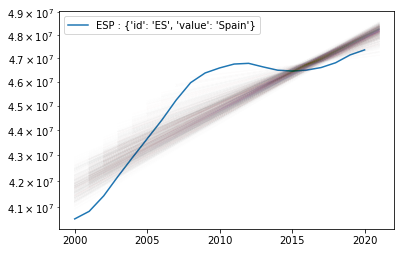

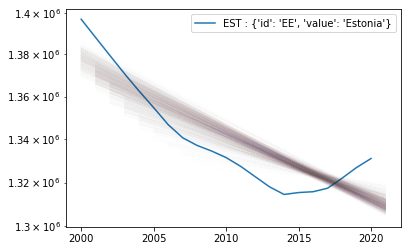

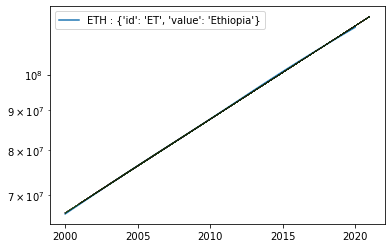

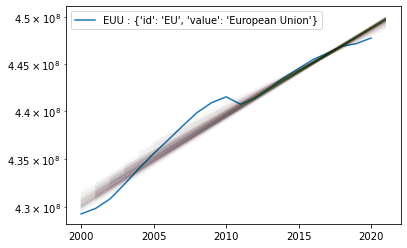

...

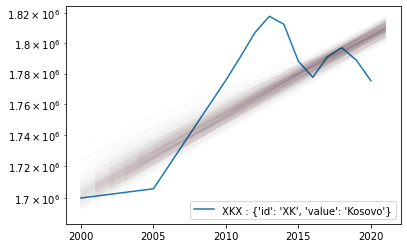

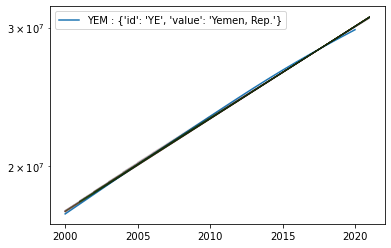

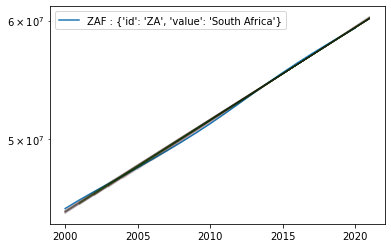

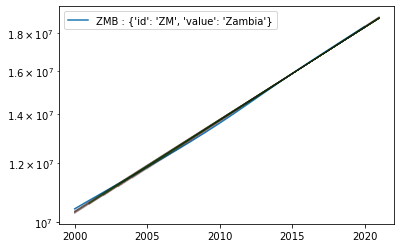

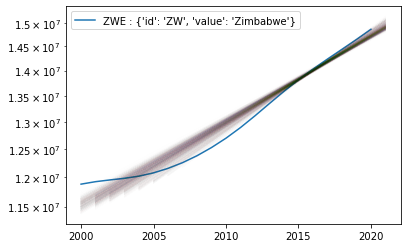

CPU times: user 8min 39s, sys: 5.33 s, total: 8min 44s
Wall time: 8min 44s


In [8]:
%%time
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    plt.plot(x,y, label = country + ' : ' + full_name_country)
    
    total_range = [i for i in range(0,20-2)]
    monteCarloValues  = []
    
    for monteCarlo in range(1000): 
        random_index = np.sort(np.unique(random.sample(total_range,7)+[20, 19, 18, 17, 16]))

        x1 = df_group.loc[country].index.tolist()
        y1 = df_group.loc[country].values.tolist()

        x = [x1[i] for i in random_index]
        y = [y1[i] for i in random_index]
        parameters, res, _, _, _  = np.polyfit(x, np.log(y), 1, full=True)
        
        x_predict = x + [2021]
        y_fit = [fit_funtion(x_i, parameters) for x_i in x_predict] 
        
        monteCarloValues.append(fit_funtion(2021, parameters))

        plt.plot(x_predict, y_fit, alpha=0.005)
        plt.yscale("log")
    plt.legend()
    plt.show()

# 2.4. Función exponencial a trozos (ventana de 4 años) + corrección (promedio de dos años anteriores)

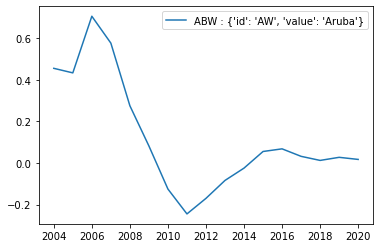

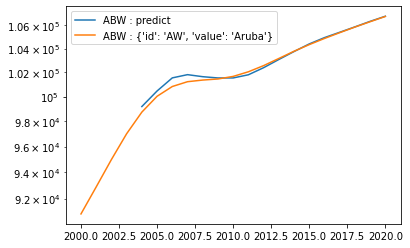

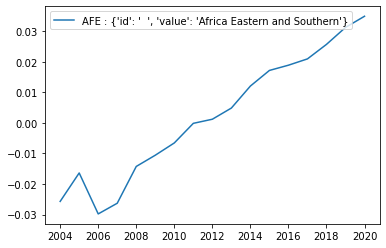

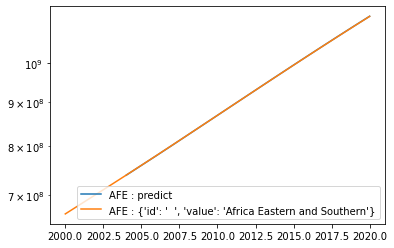

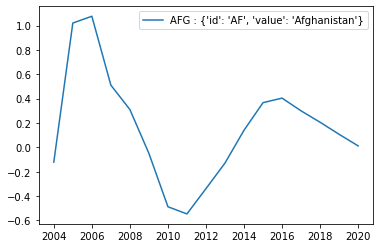

...

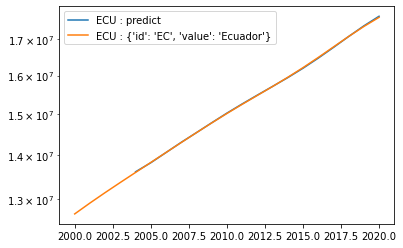

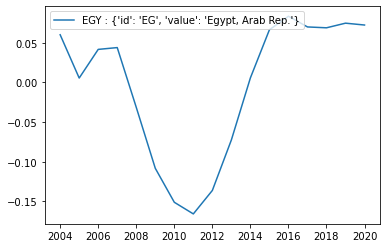

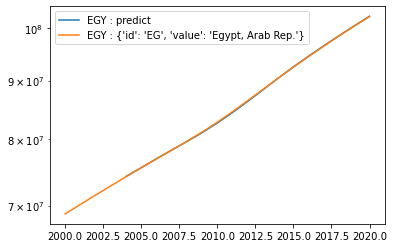

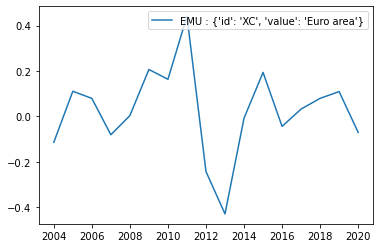

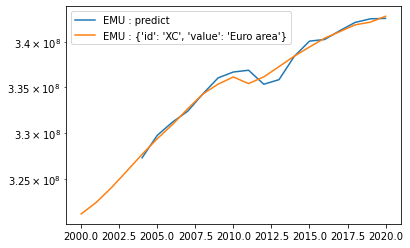

<ipython-input-9-9e86f22c45ad>:34: RuntimeWarning: divide by zero encountered in double_scalars
  delta_y_adjustment_normal.append((y_predict-y[j+4])*100/y[j+4])
<ipython-input-9-9e86f22c45ad>:17: RuntimeWarning: divide by zero encountered in log
  parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)


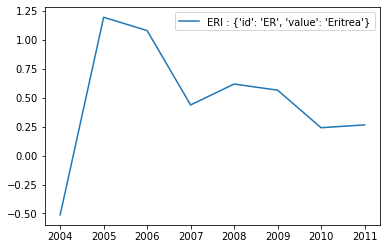

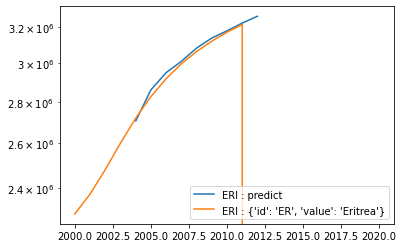

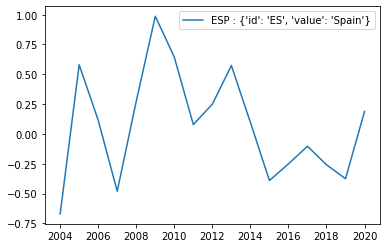

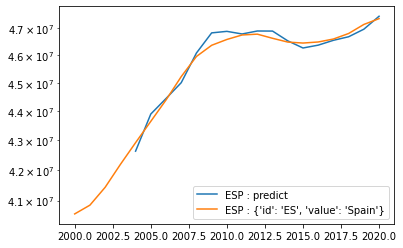

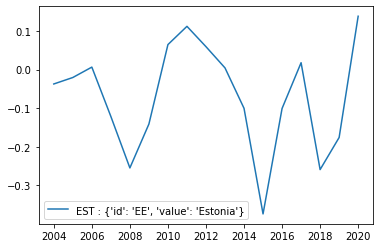

...

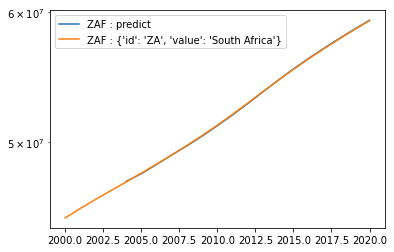

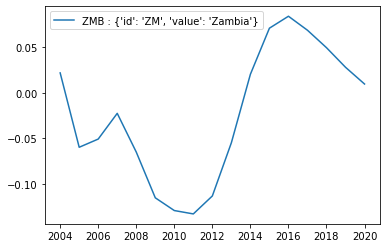

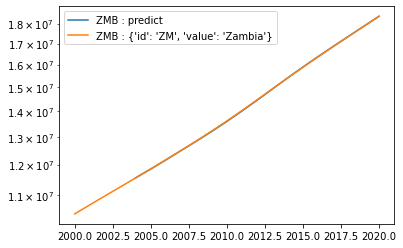

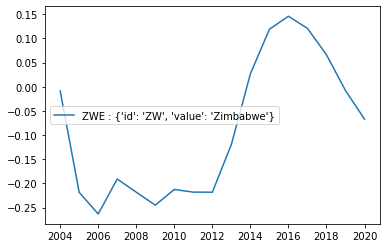

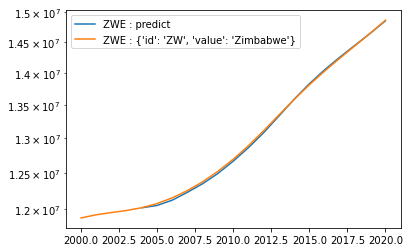

In [9]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

for country in countries: 
    full_name_country = df[df['countryiso3code']==country]['country'].values[0]
    x = df_group.loc[country].index.tolist()
    y = df_group.loc[country].values.tolist()
    
    x_adjustment = []
    y_adjustment = []
    delta_y_adjustment = []
    delta_y_adjustment_normal = []
    for j in range(len(x)-4):
        
        x1 = [x[i] for i in range(j,j+4)]
        y1 = [y[i] for i in range(j,j+4)]
        parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)
        
        if len(delta_y_adjustment) >= 2: 
            adjustment = np.mean(delta_y_adjustment[-2:])
        elif len(delta_y_adjustment) == 1: 
            adjustment = delta_y_adjustment[0]
        else: 
            adjustment = 0.1
       
        y_predict = fit_funtion(x[j+4], parameters) - adjustment
        
        # print('x1 values: ', x1)
        # print('ano: ', x[j+4], 'predict: ', y_predict, 'real: ', y[j+4], 'diff: ', y_predict - y[j+4])
        
        x_adjustment.append(x[j+4])
        y_adjustment.append(y_predict)
        delta_y_adjustment.append(y_predict-y[j+4])
        delta_y_adjustment_normal.append((y_predict-y[j+4])*100/y[j+4])
    #print(delta_y_adjustment)
    plt.plot(x_adjustment, delta_y_adjustment_normal, label = country + ' : ' + full_name_country)
    #plt.plot(x, y, label = country + ' : ' + full_name_country)
    #plt.yscale("log")
    plt.legend()
    plt.show()
    
    plt.plot(x_adjustment, y_adjustment, label = country + ' : predict')
    plt.plot(x, y, label = country + ' : ' + full_name_country)
    plt.yscale("log")
    plt.legend()
    plt.show()

# 2.5. Método lineal incluyendo otras variables, P(t, x_i) = Date + Variable_i

## 2.5.1 Predict the others variables

In [15]:
df = pd.read_csv('data/df.csv')
df_1 = pd.read_csv('data/df_1.csv')
df_2 = pd.read_csv('data/df_2.csv')
df_3 = pd.read_csv('data/df_3.csv')
df_4 = pd.read_csv('data/df_4.csv')

df_group = pd.read_csv('data/df_group.csv', index_col = ['countryiso3code', 'date'])
df_group_1 = pd.read_csv('data/df_group_1.csv', index_col = ['countryiso3code', 'date'])
df_group_2 = pd.read_csv('data/df_group_2.csv', index_col = ['countryiso3code', 'date'])
df_group_3 = pd.read_csv('data/df_group_3.csv', index_col = ['countryiso3code', 'date'])
df_group_4 = pd.read_csv('data/df_group_4.csv', index_col = ['countryiso3code', 'date'])

df_group_min_mean_max = df_group.copy()
df_group_2_min_mean_max = df_group_2.copy()
df_group_3_min_mean_max = df_group_3.copy()
df_group_4_min_mean_max = df_group_4.copy()

In [16]:
def fit_funtion(x, parameters):
    return np.exp(parameters[1])*np.exp(x*parameters[0])

def fit_funtion_error(x, parameters):
    return parameters[0]*x*x + parameters[1]*x + parameters[2]

def fit_funtion_error_line(x, parameters):
    return parameters[0]*x + parameters[1]

In [17]:
total_countries_w_errros = []

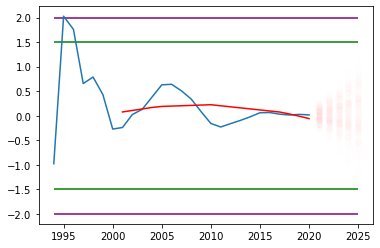

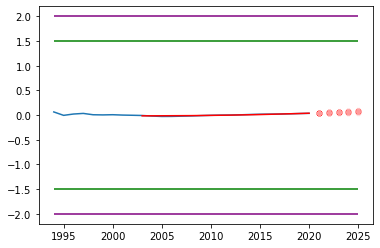

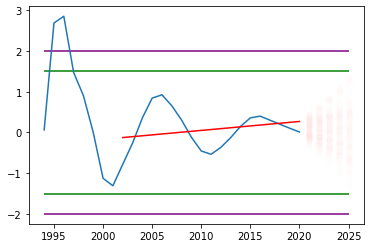

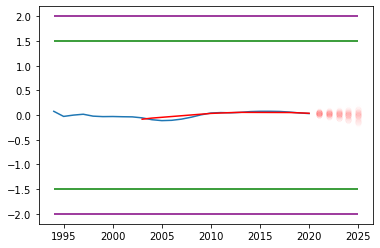

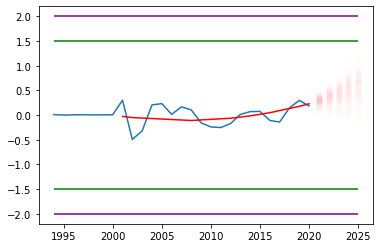

...

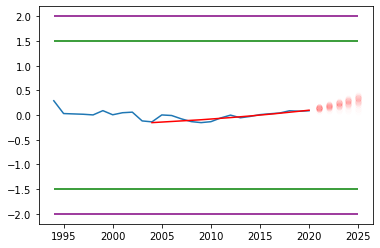

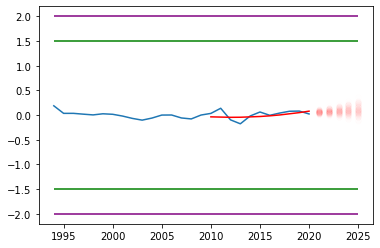

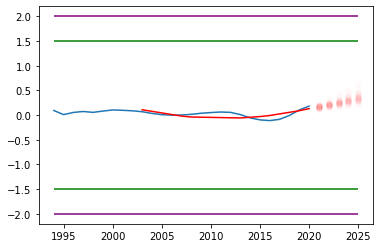

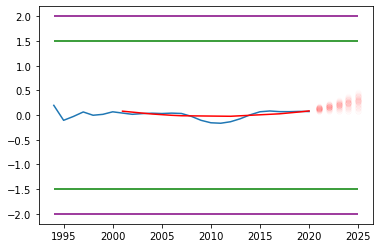

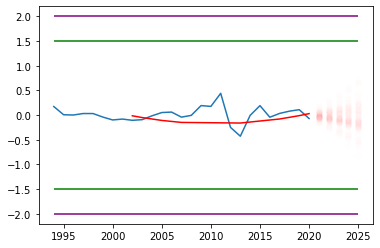

An exception occurred with  ERI


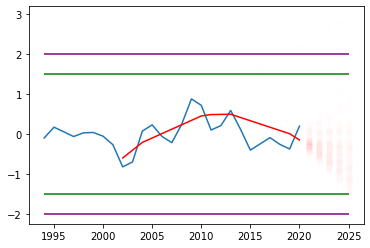

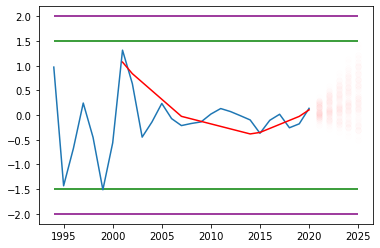

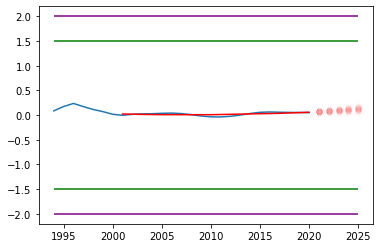

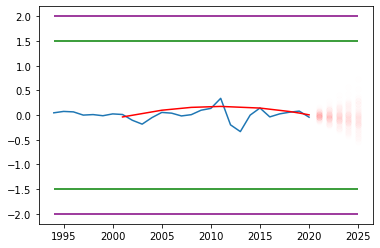

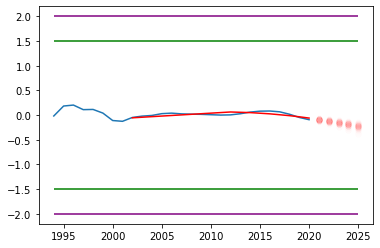

...

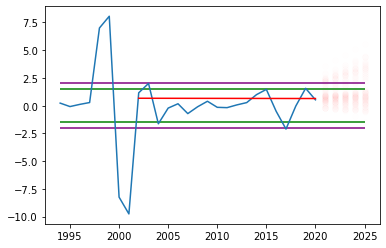

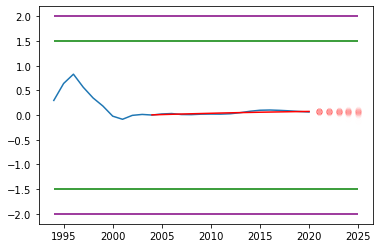

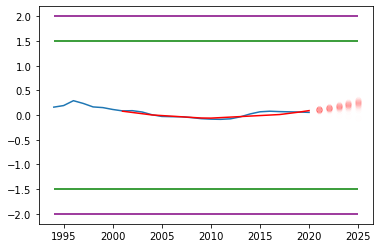

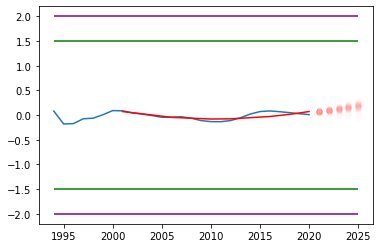

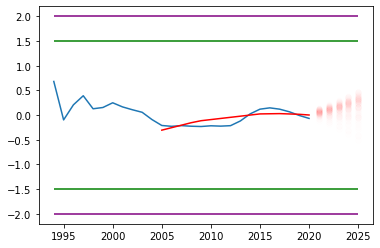

In [18]:
# Se realiza de forma manual
# Under df_group, df_group_2, df_group_3, df_group_4

countries = df_group.index.get_level_values(0).unique()

for country in countries: 
    if country not in total_countries_w_errros: 
        full_name_country = df[df['countryiso3code']==country]['country'].values[0]

        try: 
            x = df_group[df_group['value']!=0].loc[country].index.tolist()
            y = df_group[df_group['value']!=0].loc[country].values.tolist()
            
            x_min = x.copy()
            x_max = x.copy()
            y_min = y.copy()
            y_max = y.copy()
  
            if all(v[0] == 0.0 for v in y): 
                print('all zero')
                print(x)
                print(y)
                print('-------------')
                continue

            x_adjustment = []
            y_adjustment = []
            delta_y_adjustment = []
            delta_y_adjustment_normal = []

            for j in range(len(x)-4):

                x1 = [x[i] for i in range(j,j+4)]
                y1 = [y[i] for i in range(j,j+4)]

                parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)

                if len(delta_y_adjustment) >= 2: 
                    adjustment = np.mean(delta_y_adjustment[-2:])
                elif len(delta_y_adjustment) == 1: 
                    adjustment = delta_y_adjustment[0]
                else: 
                    adjustment = 0.1

                y_predict = fit_funtion(x[j+4], parameters) - adjustment

                # print('x1 values: ', x1)
                # print('ano: ', x[j+4], 'predict: ', y_predict, 'real: ', y[j+4], 'diff: ', y_predict - y[j+4])

                x_adjustment.append(x[j+4])
                y_adjustment.append(y_predict)
                delta_y_adjustment.append(y_predict-y[j+4])
                delta_y_adjustment_normal.append(((y_predict-y[j+4])*100/y_predict)[0])

            x_error_predict_extra = [float(i) for i in range(int(x_adjustment[-1]+1), 2026)]
            MonteCarlo = pd.DataFrame([], columns = x_error_predict_extra)
            
            total_range = [i for i in range(-20,-1)]
            
            for monteCarlo in range(100):
                random_index = np.sort(np.unique(random.sample(total_range,6)+[-1, -2]))

                x_error = [x_adjustment[i] for i in random_index]
                y_error = [delta_y_adjustment_normal[i] for i in random_index]
                parameters_error, res, _, _, _  = np.polyfit(x_error, y_error, 2, full=True)

                y_error_predict = [fit_funtion_error(i, parameters_error) for i in x_error]
                x_error_predict_extra = [float(i) for i in range(int(x_error[-1:][0]+1), 2026)]
                y_error_predict_extra = [fit_funtion_error(i, parameters_error) for i in x_error_predict_extra]

                #print('y_error_predict_extra', y_error_predict_extra)
                if np.abs(y_error_predict_extra[-1]) > 1.5: 

                    x_error = [x_adjustment[i] for i in random_index]
                    y_error = [delta_y_adjustment_normal[i] for i in random_index]
                    parameters_error, res, _, _, _  = np.polyfit(x_error, y_error, 1, full=True)
                    y_error_predict = [fit_funtion_error_line(i, parameters_error) for i in x_error]
                    x_error_predict_extra = [float(i) for i in range(int(x_error[-1:][0]+1), 2026)]
                    y_error_predict_extra = [fit_funtion_error_line(i, parameters_error) for i in x_error_predict_extra]
                
                MonteCarlo = MonteCarlo.append(pd.DataFrame(np.array(y_error_predict_extra).reshape(-1,len(y_error_predict_extra)), 
                                                            columns = x_error_predict_extra))
                plt.scatter(x_error_predict_extra, y_error_predict_extra, color='red', alpha = 0.004 )
            
            plt.plot(x_adjustment, delta_y_adjustment_normal, label = country + ' : ' + full_name_country)
            plt.plot(x_error, y_error_predict, color='red')  
            plt.hlines(-2, x_adjustment[0], x_error_predict_extra[-1], color = 'purple')
            plt.hlines(2, x_adjustment[0], x_error_predict_extra[-1], color = 'purple')
            plt.hlines(-1.5, x_adjustment[0], x_error_predict_extra[-1], color = 'green')
            plt.hlines(1.5, x_adjustment[0], x_error_predict_extra[-1], color = 'green')
            plt.show()
            
            delta_y_adjustment_max = delta_y_adjustment.copy()
            delta_y_adjustment_min = delta_y_adjustment.copy()
            parameters_min = parameters.copy()
            parameters_max = parameters.copy()
            for j, x_new in enumerate(x_error_predict_extra):

                MonteCarloMin = MonteCarlo[x_new].min()
                
                adjustment_min = np.mean(delta_y_adjustment_min[-2:])
                y_predict_min = fit_funtion(x_new, parameters_min) - adjustment_min
                y_real_min = (1-MonteCarloMin/100)*y_predict_min
                delta_y_adjustment_min.append(y_predict_min-y_real_min)
                x_min.append(x_new)
                y_min.append(y_real_min)
                df_group_min_mean_max.loc[(country, x_new), 'value_min'] = y_real_min
                x1_min = x_min[-4:]
                y1_min = y_min[-4:]
                parameters_min, res, _, _, _  = np.polyfit(x1_min, np.log(y1_min), 1, full=True)
                
                
                MonteCarloMean = MonteCarlo[x_new].mean()
                
                adjustment = np.mean(delta_y_adjustment[-2:])
                y_predict = fit_funtion(x_new, parameters) - adjustment
                y_real = (1-MonteCarloMean/100)*y_predict
                delta_y_adjustment.append(y_predict-y_real)
                
                x.append(x_new)
                y.append(y_real)
                df_group.loc[(country, x_new), 'value'] = y_real
                df_group_min_mean_max.loc[(country, x_new), 'value'] = y_real
                
                x1 = x[-4:]
                y1 = y[-4:]
                parameters, res, _, _, _  = np.polyfit(x1, np.log(y1), 1, full=True)
                
                
                MonteCarloMax = MonteCarlo[x_new].max()
                
                adjustment_max = np.mean(delta_y_adjustment_max[-2:])
                y_predict_max = fit_funtion(x_new, parameters_max) - adjustment_max
                y_real_max = (1-MonteCarloMax/100)*y_predict_max
                delta_y_adjustment_max.append(y_predict_max-y_real_max)
                x_max.append(x_new)
                y_max.append(y_real_max)
                df_group_min_mean_max.loc[(country, x_new), 'value_max'] = y_real_max
                x1_max = x_max[-4:]
                y1_max = y_max[-4:]
                parameters_max, res, _, _, _  = np.polyfit(x1_max, np.log(y1_max), 1, full=True)
                
                
            '''
            plt.plot(x, y, label = country + ' : ' + full_name_country, color='red')
            plt.plot(x_min, y_min, label = country + ' : ' + full_name_country, color='red', linestyle='dashed', alpha = 0.6)
            plt.plot(x_max, y_max, label = country + ' : ' + full_name_country, color='red', linestyle='dashed', alpha = 0.6)
            plt.plot(x_adjustment, y_adjustment, label = country + ' : ' + full_name_country)
            plt.legend()
            plt.show()
            '''
        except:
            print("An exception occurred with ", country) 
            total_countries_w_errros.append(country)

In [19]:
df_group_min_mean_max

value     value_min     value_max
countryiso3code date                                            
ABW             1990.0  6.215200e+04           NaN           NaN
                1991.0  6.462300e+04           NaN           NaN
                1992.0  6.824000e+04           NaN           NaN
                1993.0  7.249500e+04           NaN           NaN
                1994.0  7.670500e+04           NaN           NaN
...                              ...           ...           ...
ZWE             2021.0  1.506760e+07  1.509298e+07  1.505381e+07
                2022.0  1.527362e+07  1.535522e+07  1.523328e+07
                2023.0  1.546040e+07  1.565475e+07  1.537006e+07
                2024.0  1.562857e+07  1.601045e+07  1.546126e+07
                2025.0  1.577377e+07  1.644245e+07  1.549664e+07

[9355 rows x 3 columns]

In [20]:
df_group_min_mean_max = pd.read_csv('data/df_group_min_mean_max.csv')
df_group_2_min_mean_max = pd.read_csv('data/df_group_min_mean_max_2.csv')
df_group_3_min_mean_max = pd.read_csv('data/df_group_min_mean_max_3.csv')
df_group_4_min_mean_max = pd.read_csv('data/df_group_min_mean_max_4.csv')

df_group_min_mean_max.loc[df_group_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_min_mean_max.loc[df_group_min_mean_max['value_min'].isnull(), 'value']
df_group_min_mean_max.loc[df_group_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_min_mean_max.loc[df_group_min_mean_max['value_max'].isnull(), 'value']

df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_min'].isnull(), 'value']
df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_2_min_mean_max.loc[df_group_2_min_mean_max['value_max'].isnull(), 'value']

df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_min'].isnull(), 'value']
df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_3_min_mean_max.loc[df_group_3_min_mean_max['value_max'].isnull(), 'value']

df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_min'].isnull(), 'value_min'] = df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_min'].isnull(), 'value']
df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_max'].isnull(), 'value_max'] = df_group_4_min_mean_max.loc[df_group_4_min_mean_max['value_max'].isnull(), 'value']



df_all = df_group_2_min_mean_max.merge(df_group_3_min_mean_max, how='outer', 
                            on=['countryiso3code', 'date'], suffixes=('_2', '_3')
                                  ).merge(df_group_4_min_mean_max, how='outer', 
                                          on=['countryiso3code', 'date']
                                         ).merge(df_group_min_mean_max, how='outer',
                                                 on=['countryiso3code', 'date'], suffixes=('_4', '_0')
                                                )


df_all['value_2_log'] = np.log(df_all['value_2'])
df_all['value_3_log'] = np.log(df_all['value_3'])
df_all['value_4_log'] = np.log(df_all['value_4'])
df_all['value_0_log'] = np.log(df_all['value_0'])

/Users/charrypastrana/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:358: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [21]:
df_all

,countryiso3code,date,value_2,value_min_2,value_max_2,value_3,value_min_3,value_max_3,value_4,value_min_4,value_max_4,value_0,value_min_0,value_max_0,value_2_log,value_3_log,value_4_log,value_0_log
0,ABW,1990.0,143.482,143.482,143.482,90.078,90.078,90.078,2.249,2.249,2.249,6.215200e+04,6.215200e+04,6.215200e+04,4.966210,4.500676,0.810486,11.037338
1,ABW,1991.0,142.729,142.729,142.729,89.720,89.720,89.720,2.221,2.221,2.221,6.462300e+04,6.462300e+04,6.462300e+04,4.960948,4.496694,0.797958,11.076326
2,ABW,1992.0,141.976,141.976,141.976,89.361,89.361,89.361,2.187,2.187,2.187,6.824000e+04,6.824000e+04,6.824000e+04,4.955658,4.492684,0.782531,11.130786
3,ABW,1993.0,141.725,141.725,141.725,89.007,89.007,89.007,2.149,2.149,2.149,7.249500e+04,7.249500e+04,7.249500e+04,4.953889,4.488715,0.765003,11.191273
4,ABW,1994.0,141.475,141.475,141.475,88.653,88.653,88.653,2.108,2.108,2.108,7.670500e+04,7.670500e+04,7.670500e+04,4.952123,4.484730,0.745740,11.247722
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9350,XKX,2021.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.764898e+06,1.789281e+06,1.721299e+06,NaN,NaN,NaN,14.383603
9351,XKX,2022.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.719663e+06,1.785333e+06,1.608551e+06,NaN,NaN,NaN,14.357639
9352,XKX,2023.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.666855e+06,1.806286e+06,1.446559e+06,NaN,NaN,NaN,14.326449
9353,XKX,2024.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.597106e+06,1.841891e+06,1.246414e+06,NaN,NaN,NaN,14.283704


In [22]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn import linear_model

countries = df_all['countryiso3code'].unique()

df_all['value_KNeighbors'] = df_all['value_0'].copy()
df_all['value_KNeighbors_min'] = df_all['value_0'].copy()
df_all['value_KNeighbors_max'] = df_all['value_0'].copy()

total_countries_w_errros = []

for country in countries:
    try: 
        if country not in total_countries_w_errros: 
            if country != 'ERI' and country != 'KWT' and country != 'CPV' and country != 'GNB': 
                X = df_all[(df_all['date']<=2020) & (df_all['date']>=2015) & (df_all['countryiso3code'] == country)][['date', 'value_2', 'value_3', 'value_4']]
                Y = df_all[(df_all['date']<=2020) & (df_all['date']>=2015) & (df_all['countryiso3code'] == country)]['value_0']

                neigh = KNeighborsRegressor(n_neighbors=2)
                neigh = linear_model.Ridge(alpha=.5)
                neigh.fit(X.values, Y.values)

                X_to_predict = df_all[df_all['countryiso3code'] == country][['date', 'value_2', 'value_3', 'value_4']]
                Y_to_predict_fit = neigh.predict(X_to_predict.values)
                df_all.loc[df_all['countryiso3code'] == country, 'value_KNeighbors'] = Y_to_predict_fit

                X_to_predict = df_all[(df_all['countryiso3code'] == country)][['date', 'value_min_2', 'value_min_3', 'value_min_4']]
                Y_to_predict_fit = neigh.predict(X_to_predict.values)
                df_all.loc[df_all['countryiso3code'] == country, 'value_KNeighbors_min'] = Y_to_predict_fit

                X_to_predict = df_all[(df_all['countryiso3code'] == country) ][['date', 'value_max_2', 'value_max_3', 'value_max_4']]
                Y_to_predict_fit = neigh.predict(X_to_predict.values)
                df_all.loc[df_all['countryiso3code'] == country, 'value_KNeighbors_max'] = Y_to_predict_fit

    except:
            print("An exception occurred with ", country) 
            total_countries_w_errros.append(country)
        

An exception occurred with  AND
An exception occurred with  ASM
An exception occurred with  AUT
An exception occurred with  BLR
An exception occurred with  BMU
An exception occurred with  BRN
An exception occurred with  CUW
An exception occurred with  CYM
An exception occurred with  DMA
An exception occurred with  ECS
An exception occurred with  EST
An exception occurred with  FJI
An exception occurred with  FRO
An exception occurred with  GIB
An exception occurred with  GRL
An exception occurred with  IMN
An exception occurred with  IRL
An exception occurred with  ISL
An exception occurred with  ISR
An exception occurred with  KNA
An exception occurred with  LIE
An exception occurred with  LUX
An exception occurred with  LVA
An exception occurred with  MAF
An exception occurred with  MCO
An exception occurred with  MEX
An exception occurred with  MHL
An exception occurred with  MNP
An exception occurred with  NRU
An exception occurred with  NZL
An exception occurred with  PLW
An excep

In [23]:
total_countries_w_errros.append(['CPV', 'GNB'])

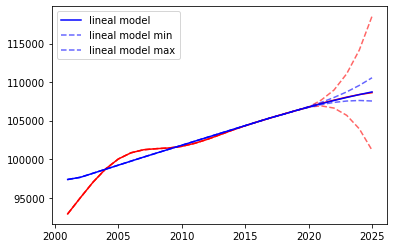

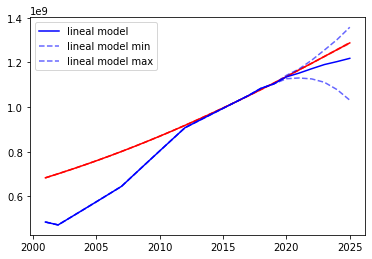

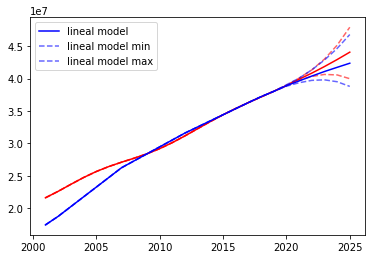

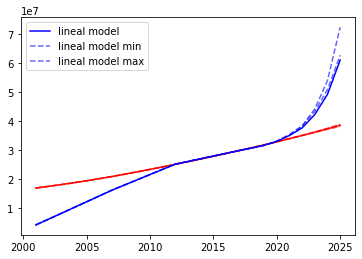

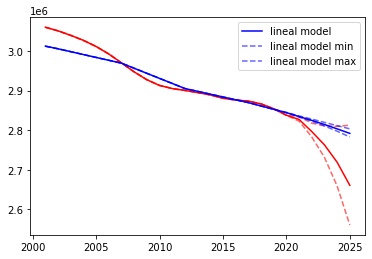

...

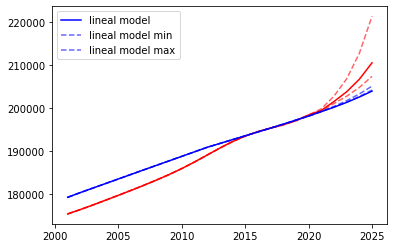

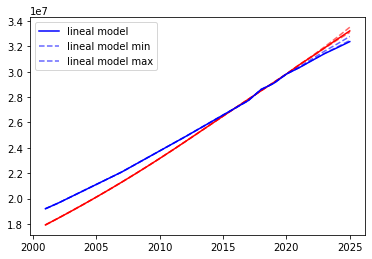

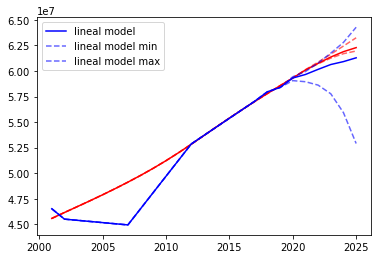

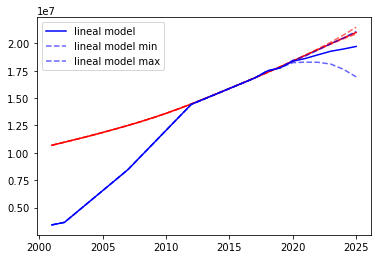

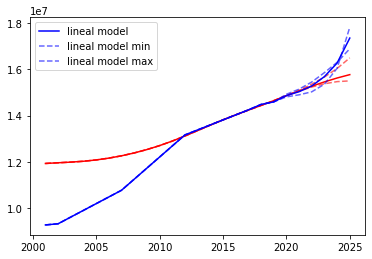

In [24]:
x_min = 2000
x_max = 2025
diff_porcentual = []

for country in countries:
    if country not in total_countries_w_errros: 
        x = df_all[ (df_all['date']>x_min) & (df_all['countryiso3code'] == country) ]['date']
        y_1 = df_all[(df_all['date']>x_min)& (df_all['countryiso3code'] == country)]['value_0']
        y_1_min = df_all[(df_all['date']>x_min)& (df_all['countryiso3code'] == country)]['value_min_0']
        y_1_max = df_all[(df_all['date']>x_min)& (df_all['countryiso3code'] == country)]['value_max_0']
        
        y_2 = df_all[(df_all['date']>x_min) & (df_all['countryiso3code'] == country)]['value_KNeighbors']
        y_2_min = df_all[(df_all['date']>x_min) & (df_all['countryiso3code'] == country)]['value_KNeighbors_min']
        y_2_max = df_all[(df_all['date']>x_min) & (df_all['countryiso3code'] == country)]['value_KNeighbors_max']
        #full_name_country = df[df['countryiso3code']==country]['country'].values[0]
        
        plt.plot(x, y_1, color='red')
        plt.plot(x, y_1_min, color='red', linestyle='dashed', alpha = 0.6)
        plt.plot(x, y_1_max, color='red', linestyle='dashed', alpha = 0.6)
        
        plt.plot(x, y_2, label='lineal model', color='blue')
        plt.plot(x, y_2_min, label='lineal model min', color='blue', linestyle='dashed', alpha = 0.6)
        plt.plot(x, y_2_max, label='lineal model max', color='blue', linestyle='dashed', alpha = 0.6)
        plt.legend()
        plt.show()

        if y_2.values[-1] != 0:
            if np.abs((y_2.values[-1]-y_1.values[-2])*100/y_2.values[-1]) < 20: 
                diff_porcentual.append((y_2.values[-1]-y_1.values[-2])*100/y_2.values[-1])